# Learning-based models (A skewed view into Neural Networks)

In [11]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import Button, Output, VBox, Checkbox, Label
from IPython.display import display

# --------------------------
# 1) Generate synthetic data
# --------------------------
np.random.seed(42)
N = 200
X = np.random.uniform(-5, 5, (N, 2))
# ground-truth: class 1 if y > x, else 0
y_true = (X[:,1] > X[:,0]).astype(int)

# --------------------------
# 2) Precompute best line by brute force
# --------------------------
def compute_accuracy(m, c):
    y_pred = (X[:,1] > (m*X[:,0] + c)).astype(int)
    return np.mean(y_pred == y_true), y_pred

# search grid
ms = np.linspace(-2, 2, 100)
cs = np.linspace(-2, 2, 100)
best_acc = 0.0
best_m, best_c = 0.0, 0.0

for m in ms:
    for c in cs:
        acc, _ = compute_accuracy(m, c)
        if acc > best_acc:
            best_acc, best_m, best_c = acc, m, c

# --------------------------
# 3) State holders
# --------------------------
current_m = None
current_c = None
last_acc = None
last_y_pred = None

# --------------------------
# 4) Widgets
# --------------------------
out = Output()
btn = Button(description="Generate Random Line", button_style='primary')
toggle = Checkbox(description="Show Best Line", value=True)
best_line_label = Label()

# --------------------------
# 5) Plotting routine
# --------------------------
def plot_decision_boundary(m, c, acc):
    with out:
        out.clear_output(wait=True)
        plt.figure(figsize=(7,7))
        # scatter by ground truth
        plt.scatter(X[y_true==0,0], X[y_true==0,1],
                    c='blue', label='Class 0 (true)')
        plt.scatter(X[y_true==1,0], X[y_true==1,1],
                    c='red',  label='Class 1 (true)')
        # random line
        xs = np.array([-5,5])
        plt.plot(xs, m*xs + c, 'k-', linewidth=2, label='Random Line')
        # best line?
        if toggle.value:
            plt.plot(xs, best_m*xs + best_c, 'k--', linewidth=2,
                     label=f'Best Line (m={best_m:.2f}, c={best_c:.2f})')
            best_line_label.value = (
                f"Best line → slope = {best_m:.2f}, intercept = {best_c:.2f}"
            )
        else:
            best_line_label.value = ""
        plt.xlim(-5,5)
        plt.ylim(-5,5)
        plt.title(f"Accuracy: {acc*100:.2f}%")
        plt.legend(loc='lower left')
        plt.show()

# --------------------------
# 6) Button callback
# --------------------------
def on_button_clicked(_):
    global current_m, current_c, last_acc, last_y_pred
    # pick new random line
    current_m = np.random.uniform(-2,2)
    current_c = np.random.uniform(-2,2)
    last_acc, last_y_pred = compute_accuracy(current_m, current_c)
    plot_decision_boundary(current_m, current_c, last_acc)

btn.on_click(on_button_clicked)

# --------------------------
# 7) Toggle callback (redraw same line)
# --------------------------
def on_toggle_change(change):
    if change['name']=='value' and current_m is not None:
        plot_decision_boundary(current_m, current_c, last_acc)

toggle.observe(on_toggle_change)

# --------------------------
# 8) Display
# --------------------------
display(VBox([btn, toggle, best_line_label, out]))

# initial draw
on_button_clicked(None)

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# --------------------------
# 1) Generate synthetic data
# --------------------------
np.random.seed(0)
N = 200
X = np.random.uniform(-5, 5, (N, 2))
y = (X[:, 1] > X[:, 0]).astype(int)  # true labels

# Add bias term to X
X_bias = np.hstack([np.ones((N, 1)), X])  # shape (N, 3)

# --------------------------
# 2) Logistic regression GD
# --------------------------
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

# Hyperparameters
lr = 0.1
n_iters = 100

# Initialize θ = [b, w1, w2]
theta = np.random.randn(3) * 0.5

# Store θ at each step
thetas = np.zeros((n_iters, 3))

for i in range(n_iters):
    z = X_bias.dot(theta)
    y_pred = sigmoid(z)
    grad = (X_bias.T.dot(y_pred - y)) / N
    theta -= lr * grad
    thetas[i] = theta.copy()

# --------------------------
# 3) Set up the figure
# --------------------------
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_xlim(-5, 5)
ax.set_ylim(-5, 5)

# scatter ground-truth
ax.scatter(X[y == 0, 0], X[y == 0, 1], c='blue', label='Class 0')
ax.scatter(X[y == 1, 0], X[y == 1, 1], c='red',  label='Class 1')

# line that will be updated
line, = ax.plot([], [], 'k-', linewidth=2)
title = ax.text(0.5, 1.03, "", transform=ax.transAxes, ha='center')

ax.legend(loc='lower right')

# --------------------------
# 4) Animation functions
# --------------------------
def init():
    line.set_data([], [])
    title.set_text("")
    return line, title

def update(frame):
    th0, th1, th2 = thetas[frame]
    # decision boundary: th0 + th1*x + th2*y = 0  →  y = -(th0 + th1*x)/th2
    xs = np.array([-5, 5])
    ys = -(th0 + th1 * xs) / th2
    line.set_data(xs, ys)

    # compute accuracy at this θ
    preds = sigmoid(X_bias.dot(thetas[frame])) > 0.5
    acc = np.mean(preds == y)

    title.set_text(f"Iter {frame+1}/{n_iters}   Accuracy: {acc*100:.1f}%")
    return line, title

anim = animation.FuncAnimation(
    fig, update, frames=n_iters, init_func=init,
    blit=True, interval=200, repeat=False
)

# --------------------------
# 5) Display in Jupyter
# --------------------------
plt.close(fig)       # hide extra static plot
HTML(anim.to_jshtml())

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display

# --------------------------
# 1) Generate “donut” data
# --------------------------
np.random.seed(0)
N = 400

# inner circle (class 0)
r1     = np.random.randn(N//2) * 0.2 + 1.0
theta1 = np.random.rand(N//2) * 2 * np.pi
X1     = np.column_stack([r1 * np.cos(theta1),
                          r1 * np.sin(theta1)])
y1     = np.zeros(N//2, dtype=int)

# outer ring (class 1)
r2     = np.random.randn(N//2) * 0.2 + 2.5
theta2 = np.random.rand(N//2) * 2 * np.pi
X2     = np.column_stack([r2 * np.cos(theta2),
                          r2 * np.sin(theta2)])
y2     = np.ones(N//2, dtype=int)

# combine
X = np.vstack([X1, X2])   # shape (N,2)
y = np.hstack([y1, y2])   # shape (N,)

# --------------------------
# 2) Polynomial features (degree 2)
#    φ(x,y) = [1, x, y, x², x·y, y²]
# --------------------------
def poly_features(X):
    x, y = X[:,0], X[:,1]
    return np.column_stack([
        np.ones(len(X)), x, y, x**2, x*y, y**2
    ])

X_poly = poly_features(X)  # shape (N,6)

# --------------------------
# 3) Logistic regression via gradient descent
# --------------------------
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

lr      = 0.1
n_iters = 100
m       = X_poly.shape[0]

theta = np.zeros(X_poly.shape[1])  # θ₀…θ₅
history = []

for i in range(n_iters):
    z      = X_poly.dot(theta)      # shape (N,)
    pred   = sigmoid(z)
    grad   = (X_poly.T.dot(pred - y)) / m
    theta -= lr * grad
    history.append(theta.copy())

# --------------------------
# 4) Prepare grid for plotting
# --------------------------
xs = np.linspace(-3, 3, 200)
ys = np.linspace(-3, 3, 200)
xx, yy = np.meshgrid(xs, ys)
grid   = np.column_stack([xx.ravel(), yy.ravel()])
grid_poly = poly_features(grid)   # shape (200*200,6)

# --------------------------
# 5) Set up figure
# --------------------------
fig, ax = plt.subplots(figsize=(6,6))
ax.set_xlim(-3, 3)
ax.set_ylim(-3, 3)

# --------------------------
# 6) Animation update
# --------------------------
def update(frame):
    ax.cla()
    ax.set_xlim(-3, 3)
    ax.set_ylim(-3, 3)
    # scatter by ground truth
    ax.scatter(X[y==0,0], X[y==0,1], c='blue', label='Class 0')
    ax.scatter(X[y==1,0], X[y==1,1], c='red',  label='Class 1')
    # compute prediction probabilities on grid
    θ = history[frame]
    Z = sigmoid(grid_poly.dot(θ)).reshape(xx.shape)
    # contour at p=0.5
    ax.contour(xx, yy, Z, levels=[0.5], colors='black', linewidths=2)
    ax.set_title(f"Iteration {frame+1}/{n_iters}", pad=12)
    ax.legend(loc='upper right')

# --------------------------
# 7) Create animation
# --------------------------
anim = animation.FuncAnimation(
    fig, update,
    frames=n_iters,
    blit=False,
    interval=200,
    repeat=False
)

# --------------------------
# 8) Display in Jupyter
# --------------------------
plt.close(fig)
display(HTML(anim.to_jshtml()))

# --------------------------
# 9) Print final boundary equation
# --------------------------
θ0, θ1, θ2, θ3, θ4, θ5 = theta
print(
    "Final decision boundary (p=0.5):\n"
    f"0 = {θ0:.3f} + {θ1:.3f}·x + {θ2:.3f}·y "
    f"+ {θ3:.3f}·x² + {θ4:.3f}·x·y + {θ5:.3f}·y²"
)

Final decision boundary (p=0.5):
0 = -1.508 + -0.069·x + -0.056·y + 0.641·x² + -0.081·x·y + 0.672·y²


In [3]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display

# --------------------------
# 1) Generate “donut” data
# --------------------------
np.random.seed(0)
N = 400

# inner circle (class 0)
r1     = np.random.randn(N//2) * 0.2 + 1.0
θ1     = np.random.rand(N//2) * 2 * np.pi
X1     = np.column_stack([r1 * np.cos(θ1), r1 * np.sin(θ1)])
y1     = np.zeros(N//2, dtype=int)

# outer ring (class 1)
r2     = np.random.randn(N//2) * 0.2 + 2.5
θ2     = np.random.rand(N//2) * 2 * np.pi
X2     = np.column_stack([r2 * np.cos(θ2), r2 * np.sin(θ2)])
y2     = np.ones(N//2, dtype=int)

# combine
X = np.vstack([X1, X2])   # shape (N,2)
y = np.hstack([y1, y2])   # shape (N,)

# --------------------------
# 2) Build a 3-layer MLP
#    input → hidden1(tanh) → hidden2(tanh) → output(sigmoid)
# --------------------------
def sigmoid(z): return 1/(1+np.exp(-z))

# network dimensions
D = 2
H1 = 16
H2 = 8

# initialize weights & biases
np.random.seed(1)
W1 = np.random.randn(H1, D) * 0.1
b1 = np.zeros((H1, 1))
W2 = np.random.randn(H2, H1) * 0.1
b2 = np.zeros((H2, 1))
W3 = np.random.randn(1, H2) * 0.1
b3 = np.zeros((1, 1))

# training hyperparams
lr      = 0.1
n_iters = 200
params_history = []

# training loop (batch GD)
for i in range(n_iters):
    # forward
    Z1 = W1.dot(X.T) + b1        # (H1, N)
    A1 = np.tanh(Z1)
    Z2 = W2.dot(A1) + b2         # (H2, N)
    A2 = np.tanh(Z2)
    Z3 = W3.dot(A2) + b3         # (1, N)
    A3 = sigmoid(Z3)             # (1, N)

    # compute gradient of loss w.r.t. Z3
    m = N
    dZ3 = A3 - y.reshape(1, -1)  # (1, N)
    dW3 = (dZ3.dot(A2.T)) / m    # (1, H2)
    db3 = np.sum(dZ3, axis=1, keepdims=True) / m

    # backprop to layer2
    dA2 = W3.T.dot(dZ3)          # (H2, N)
    dZ2 = dA2 * (1 - A2**2)      # (H2, N)
    dW2 = (dZ2.dot(A1.T)) / m    # (H2, H1)
    db2 = np.sum(dZ2, axis=1, keepdims=True) / m

    # backprop to layer1
    dA1 = W2.T.dot(dZ2)          # (H1, N)
    dZ1 = dA1 * (1 - A1**2)      # (H1, N)
    dW1 = (dZ1.dot(X)) / m       # (H1, D)
    db1 = np.sum(dZ1, axis=1, keepdims=True) / m

    # gradient descent update
    W3 -= lr * dW3; b3 -= lr * db3
    W2 -= lr * dW2; b2 -= lr * db2
    W1 -= lr * dW1; b1 -= lr * db1

    # record params
    params_history.append((W1.copy(), b1.copy(),
                           W2.copy(), b2.copy(),
                           W3.copy(), b3.copy()))

# --------------------------
# 3) Prepare a grid for boundary plotting
# --------------------------
xs = np.linspace(-3, 3, 200)
ys = np.linspace(-3, 3, 200)
xx, yy = np.meshgrid(xs, ys)
grid = np.column_stack([xx.ravel(), yy.ravel()])  # (40000, 2)

# --------------------------
# 4) Set up figure + scatter
# --------------------------
fig, ax = plt.subplots(figsize=(6,6))
ax.set_xlim(-3, 3); ax.set_ylim(-3, 3)
ax.scatter(X[y==0,0], X[y==0,1], c='blue', label='Class 0')
ax.scatter(X[y==1,0], X[y==1,1], c='red',  label='Class 1')
ax.legend(loc='upper right')
title = ax.text(0.5, 1.03, '', transform=ax.transAxes, ha='center')

# --------------------------
# 5) Animation update function
# --------------------------
def update(frame):
    ax.cla()
    ax.set_xlim(-3, 3); ax.set_ylim(-3, 3)
    # re-plot data
    ax.scatter(X[y==0,0], X[y==0,1], c='blue')
    ax.scatter(X[y==1,0], X[y==1,1], c='red')
    # get params
    W1_i, b1_i, W2_i, b2_i, W3_i, b3_i = params_history[frame]
    # forward on grid
    Z1g = W1_i.dot(grid.T) + b1_i
    A1g = np.tanh(Z1g)
    Z2g = W2_i.dot(A1g) + b2_i
    A2g = np.tanh(Z2g)
    Z3g = W3_i.dot(A2g) + b3_i
    Pg  = sigmoid(Z3g).reshape(xx.shape)
    # draw 0.5 contour
    ax.contour(xx, yy, Pg, levels=[0.5], colors='black', linewidths=2)
    ax.set_title(f"Iteration {frame+1}/{n_iters}")
    return []

# --------------------------
# 6) Create & display animation
# --------------------------
anim = animation.FuncAnimation(
    fig, update, frames=n_iters,
    blit=False, interval=100, repeat=False
)
plt.close(fig)
display(HTML(anim.to_jshtml()))

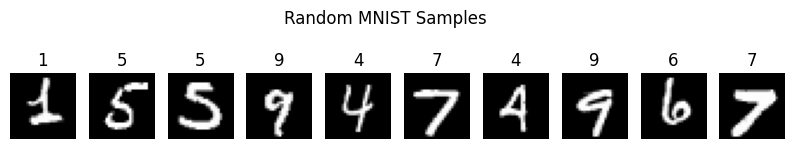

Test accuracy: 97.28%


In [8]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import fetch_openml
from sklearn.model_selection import train_test_split

# --------------------------
# 1) Load MNIST from sklearn
# --------------------------
mnist = fetch_openml('mnist_784', version=1, as_frame=False)
X, y = mnist['data'], mnist['target'].astype(int)

# Normalize pixel values to [0,1]
X = X / 255.0

# --------------------------
# 2) Visualize some samples
# --------------------------
plt.figure(figsize=(10, 2))
indices = np.random.choice(X.shape[0], 10, replace=False)
for i, idx in enumerate(indices):
    plt.subplot(1, 10, i + 1)
    plt.imshow(X[idx].reshape(28, 28), cmap='gray')
    plt.axis('off')
    plt.title(y[idx])
plt.suptitle("Random MNIST Samples")
plt.show()

# --------------------------
# 3) Train / test split
# --------------------------
X_train, X_test, y_train_int, y_test_int = train_test_split(
    X, y, test_size=10000, random_state=42
)

# One‐hot encode labels
num_classes = 10
y_train = np.eye(num_classes)[y_train_int]
y_test  = np.eye(num_classes)[y_test_int]

# --------------------------
# 4) Define a 2‐layer NN
#    Input (784) → Hidden (128, ReLU) → Output (10, softmax)
# --------------------------
def relu(Z):
    return np.maximum(0, Z)

def relu_deriv(Z):
    return (Z > 0).astype(float)

def softmax(Z):
    expZ = np.exp(Z - Z.max(axis=1, keepdims=True))
    return expZ / expZ.sum(axis=1, keepdims=True)

# Initialize weights
rng = np.random.RandomState(1)
input_size, hidden_size, output_size = 784, 128, 10
W1 = rng.randn(input_size, hidden_size) * np.sqrt(2.0 / input_size)
b1 = np.zeros((1, hidden_size))
W2 = rng.randn(hidden_size, output_size) * np.sqrt(2.0 / hidden_size)
b2 = np.zeros((1, output_size))

# --------------------------
# 5) Training hyperparameters
# --------------------------
lr = 0.1
epochs = 10
batch_size = 64
n_train = X_train.shape[0]

# --------------------------
# 6) Training loop (mini‐batch GD)
# --------------------------
for epoch in range(epochs):
    # Shuffle training data
    perm = rng.permutation(n_train)
    X_train, y_train = X_train[perm], y_train[perm]
    
    for i in range(0, n_train, batch_size):
        X_batch = X_train[i : i + batch_size]
        y_batch = y_train[i : i + batch_size]
        
        # Forward pass
        Z1 = X_batch.dot(W1) + b1           # (batch, hidden_size)
        A1 = relu(Z1)
        Z2 = A1.dot(W2) + b2               # (batch, output_size)
        A2 = softmax(Z2)
        
        # Backward pass
        m = X_batch.shape[0]
        dZ2 = (A2 - y_batch) / m           # (batch, output_size)
        dW2 = A1.T.dot(dZ2)                # (hidden_size, output_size)
        db2 = dZ2.sum(axis=0, keepdims=True)
        
        dA1 = dZ2.dot(W2.T)                # (batch, hidden_size)
        dZ1 = dA1 * relu_deriv(Z1)
        dW1 = X_batch.T.dot(dZ1)           # (input_size, hidden_size)
        db1 = dZ1.sum(axis=0, keepdims=True)
        
        # Parameter update
        W2 -= lr * dW2
        b2 -= lr * db2
        W1 -= lr * dW1
        b1 -= lr * db1

    # Optionally print progress
    # train_preds = np.argmax(softmax(relu(X_train.dot(W1)+b1).dot(W2)+b2), axis=1)
    # train_acc = np.mean(train_preds == np.argmax(y_train, axis=1))
    # print(f"Epoch {epoch+1}/{epochs}: train acc {train_acc*100:.2f}%")

# --------------------------
# 7) Evaluate on test set
# --------------------------
A1_test = relu(X_test.dot(W1) + b1)
A2_test = softmax(A1_test.dot(W2) + b2)
y_pred = np.argmax(A2_test, axis=1)
y_true = np.argmax(y_test, axis=1)

test_acc = np.mean(y_pred == y_true)
print(f"Test accuracy: {test_acc*100:.2f}%")

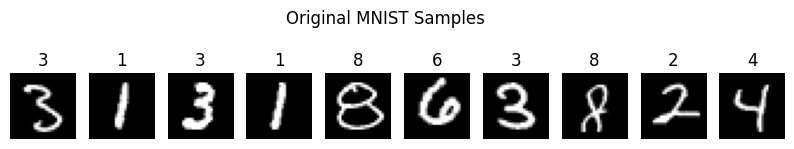

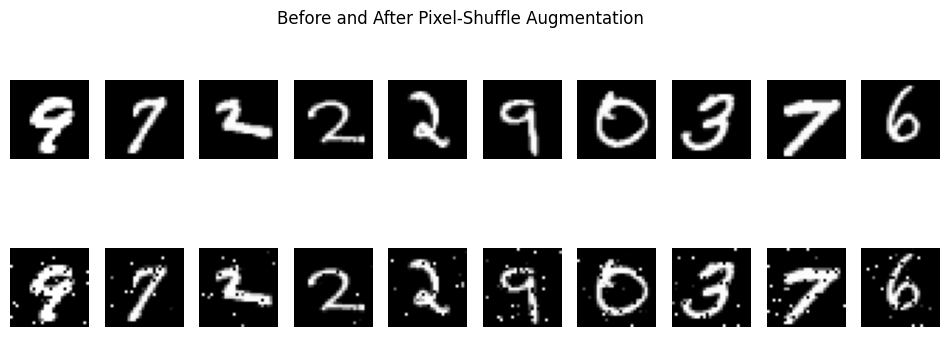

Original training set test accuracy:   97.22%
Augmented training set test accuracy: 96.99%


In [9]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import fetch_openml
from sklearn.model_selection import train_test_split

# --------------------------
# 1) Load MNIST and normalize
# --------------------------
mnist = fetch_openml('mnist_784', version=1, as_frame=False)
X, y = mnist['data'], mnist['target'].astype(int)
X = X / 255.0

# --------------------------
# 2) Show random samples before augmentation
# --------------------------
plt.figure(figsize=(10,2))
idxs = np.random.choice(len(X), 10, replace=False)
for i, idx in enumerate(idxs):
    plt.subplot(1, 10, i+1)
    plt.imshow(X[idx].reshape(28,28), cmap='gray')
    plt.axis('off')
    plt.title(y[idx])
plt.suptitle("Original MNIST Samples")
plt.show()

# --------------------------
# 3) Train/test split & one-hot encode
# --------------------------
X_train, X_test, y_train_int, y_test_int = train_test_split(
    X, y, test_size=10000, random_state=42
)
num_classes = 10
y_train = np.eye(num_classes)[y_train_int]
y_test  = np.eye(num_classes)[y_test_int]

# --------------------------
# 4) Define augmentation: shuffle 10% of pixels per image
# --------------------------
def augment_images(X, shuffle_frac=0.1):
    X_aug = np.empty_like(X)
    n_pixels = X.shape[1]
    n_shuffle = int(shuffle_frac * n_pixels)
    for i, img in enumerate(X):
        flat = img.copy()
        idxs = np.random.choice(n_pixels, size=n_shuffle, replace=False)
        vals = flat[idxs]
        np.random.shuffle(vals)
        flat[idxs] = vals
        X_aug[i] = flat
    return X_aug

X_train_aug = augment_images(X_train, shuffle_frac=0.1)

# --------------------------
# 5) Show before & after augmentation
# --------------------------
plt.figure(figsize=(12, 4))
samples = np.random.choice(len(X_train), 10, replace=False)
for i, idx in enumerate(samples):
    # original
    plt.subplot(2, 10, i+1)
    plt.imshow(X_train[idx].reshape(28,28), cmap='gray')
    plt.axis('off')
    if i == 0:
        plt.ylabel("Original")
    # augmented
    plt.subplot(2, 10, 10 + i+1)
    plt.imshow(X_train_aug[idx].reshape(28,28), cmap='gray')
    plt.axis('off')
    if i == 0:
        plt.ylabel("Shuffled")
plt.suptitle("Before and After Pixel-Shuffle Augmentation")
plt.show()

# --------------------------
# 6) Define network & helpers
# --------------------------
def relu(Z): return np.maximum(0, Z)
def relu_deriv(Z): return (Z > 0).astype(float)
def softmax(Z):
    expZ = np.exp(Z - Z.max(axis=1, keepdims=True))
    return expZ / expZ.sum(axis=1, keepdims=True)

def train_and_evaluate(X_tr, y_tr, X_te, y_te):
    rng = np.random.RandomState(1)
    # initialize weights
    input_size, hidden_size, output_size = 784, 128, 10
    W1 = rng.randn(input_size, hidden_size) * np.sqrt(2.0/input_size)
    b1 = np.zeros((1, hidden_size))
    W2 = rng.randn(hidden_size, output_size) * np.sqrt(2.0/hidden_size)
    b2 = np.zeros((1, output_size))
    
    # training hyperparams
    lr = 0.1
    epochs = 10
    batch_size = 64
    n_train = X_tr.shape[0]
    
    # training loop
    for epoch in range(epochs):
        perm = rng.permutation(n_train)
        X_shuf = X_tr[perm]
        y_shuf = y_tr[perm]
        for i in range(0, n_train, batch_size):
            X_batch = X_shuf[i:i+batch_size]
            y_batch = y_shuf[i:i+batch_size]
            # forward
            Z1 = X_batch.dot(W1) + b1
            A1 = relu(Z1)
            Z2 = A1.dot(W2) + b2
            A2 = softmax(Z2)
            # backward
            m = X_batch.shape[0]
            dZ2 = (A2 - y_batch) / m
            dW2 = A1.T.dot(dZ2)
            db2 = dZ2.sum(axis=0, keepdims=True)
            dA1 = dZ2.dot(W2.T)
            dZ1 = dA1 * relu_deriv(Z1)
            dW1 = X_batch.T.dot(dZ1)
            db1 = dZ1.sum(axis=0, keepdims=True)
            # update
            W2 -= lr * dW2; b2 -= lr * db2
            W1 -= lr * dW1; b1 -= lr * db1
    
    # evaluate
    A1_te = relu(X_te.dot(W1) + b1)
    A2_te = softmax(A1_te.dot(W2) + b2)
    preds = np.argmax(A2_te, axis=1)
    true  = np.argmax(y_te, axis=1)
    return np.mean(preds == true)

# --------------------------
# 7) Train & evaluate on both sets
# --------------------------
acc_orig = train_and_evaluate(X_train,     y_train, X_test, y_test)
acc_aug  = train_and_evaluate(X_train_aug, y_train, X_test, y_test)

# --------------------------
# 8) Print final results
# --------------------------
print(f"Original training set test accuracy:   {acc_orig*100:.2f}%")
print(f"Augmented training set test accuracy: {acc_aug*100:.2f}%")

In [10]:
import numpy as np
from sklearn.datasets import fetch_openml
from sklearn.model_selection import train_test_split

# --------------------------
# 1) Load MNIST and normalize
# --------------------------
mnist = fetch_openml('mnist_784', version=1, as_frame=False)
X, y = mnist['data'], mnist['target'].astype(int)
X = X / 255.0

# --------------------------
# 2) Train/test split
# --------------------------
X_train, X_test, y_train_int, y_test_int = train_test_split(
    X, y, test_size=10000, random_state=42
)

# --------------------------
# 3) Encode labels as 4-bit binary vectors
# --------------------------
def int_to_bits(labels, num_bits=4):
    # MSB first: bit values [8,4,2,1]
    bits = ((labels.reshape(-1,1) >> np.arange(num_bits)[::-1]) & 1)
    return bits.astype(float)

def bits_to_int(bits):
    # bits shape (N,4), MSB first
    weights = 2**np.arange(bits.shape[1]-1, -1, -1)
    return bits.dot(weights)

y_train = int_to_bits(y_train_int, num_bits=4)
y_test  = int_to_bits(y_test_int,  num_bits=4)

# --------------------------
# 4) Define network & helpers
#    784 → 128 (ReLU) → 4 (sigmoid)
# --------------------------
def relu(Z):
    return np.maximum(0, Z)

def relu_deriv(Z):
    return (Z > 0).astype(float)

def sigmoid(Z):
    return 1 / (1 + np.exp(-Z))

rng = np.random.RandomState(1)
input_size, hidden_size, output_size = 784, 128, 4

W1 = rng.randn(input_size, hidden_size) * np.sqrt(2.0/input_size)
b1 = np.zeros((1, hidden_size))
W2 = rng.randn(hidden_size, output_size) * np.sqrt(2.0/hidden_size)
b2 = np.zeros((1, output_size))

# --------------------------
# 5) Training hyperparameters
# --------------------------
lr = 0.1
epochs = 10
batch_size = 64
n_train = X_train.shape[0]

# --------------------------
# 6) Training loop
# --------------------------
for epoch in range(1, epochs+1):
    # shuffle
    perm = rng.permutation(n_train)
    X_shuf = X_train[perm]
    y_shuf = y_train[perm]
    
    for i in range(0, n_train, batch_size):
        X_batch = X_shuf[i:i+batch_size]
        y_batch = y_shuf[i:i+batch_size]
        
        # forward
        Z1 = X_batch.dot(W1) + b1          # (batch,128)
        A1 = relu(Z1)
        Z2 = A1.dot(W2) + b2               # (batch,4)
        A2 = sigmoid(Z2)                   # (batch,4)
        
        # backward (binary cross-entropy)
        m = X_batch.shape[0]
        dZ2 = (A2 - y_batch) / m           # (batch,4)
        dW2 = A1.T.dot(dZ2)                # (128,4)
        db2 = dZ2.sum(axis=0, keepdims=True)
        
        dA1 = dZ2.dot(W2.T)                # (batch,128)
        dZ1 = dA1 * relu_deriv(Z1)
        dW1 = X_batch.T.dot(dZ1)           # (784,128)
        db1 = dZ1.sum(axis=0, keepdims=True)
        
        # update
        W2 -= lr * dW2;  b2 -= lr * db2
        W1 -= lr * dW1;  b1 -= lr * db1

# --------------------------
# 7) Evaluate on test set
# --------------------------
# forward
A1_test = relu(X_test.dot(W1) + b1)
A2_test = sigmoid(A1_test.dot(W2) + b2)  # (n_test,4)

# threshold bits at 0.5
bits_pred = (A2_test >= 0.5).astype(int)
y_pred_int = bits_to_int(bits_pred)
y_true_int = y_test_int

# classification accuracy
accuracy = np.mean(y_pred_int == y_true_int)
print(f"Test accuracy (4-bit encoding): {accuracy*100:.2f}%")

Test accuracy (4-bit encoding): 94.49%
